<a href="https://colab.research.google.com/github/FalaahArifKhan/RAI-summer-stability/blob/main/EDA/N_A_TX_NY_2016.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Imports

In [1]:
import pandas as pd
import numpy as np

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, accuracy_score, pairwise_distances, DistanceMetric

from collections import defaultdict
from sys import getsizeof
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.preprocessing import OneHotEncoder
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, accuracy_score, f1_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
import statsmodels.api as sm
from copy import deepcopy

import sys
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

from pprint import pprint


import warnings
warnings.filterwarnings('ignore')

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
from IPython.display import clear_output 
try:
    from folktables import ACSDataSource, ACSEmployment, ACSIncome, \
    ACSPublicCoverage, ACSMobility, ACSTravelTime
except:
    !pip install folktables
    from folktables import ACSDataSource, ACSEmployment, ACSIncome, \
    ACSPublicCoverage, ACSMobility, ACSTravelTime
    clear_output()

## Data profiling

## TX

### Plans:

1. Take difference of df1 (with nulls) and df2 (without nulls)
2. Check if number of nulls in SCHL is the same as children under 3 y.o.
3. Dig into Alaska Native and their ESR equals 1 in NY.
4. Why so round numbers in NY?
5. Why so many nulls in ESP?
6. What is the distribution of ESR nulls among sensitive categories? Race and gender.
7. ESP nulls distribution among race and sex.
8. MIL, DREM nulls distribution.
9. Dig into age anomaly (spike in 92-95 y.o.). But the age should be in 16-90 range.
10. Take all datasets and check if age restrictions are satisfied.

In the end, try another states.

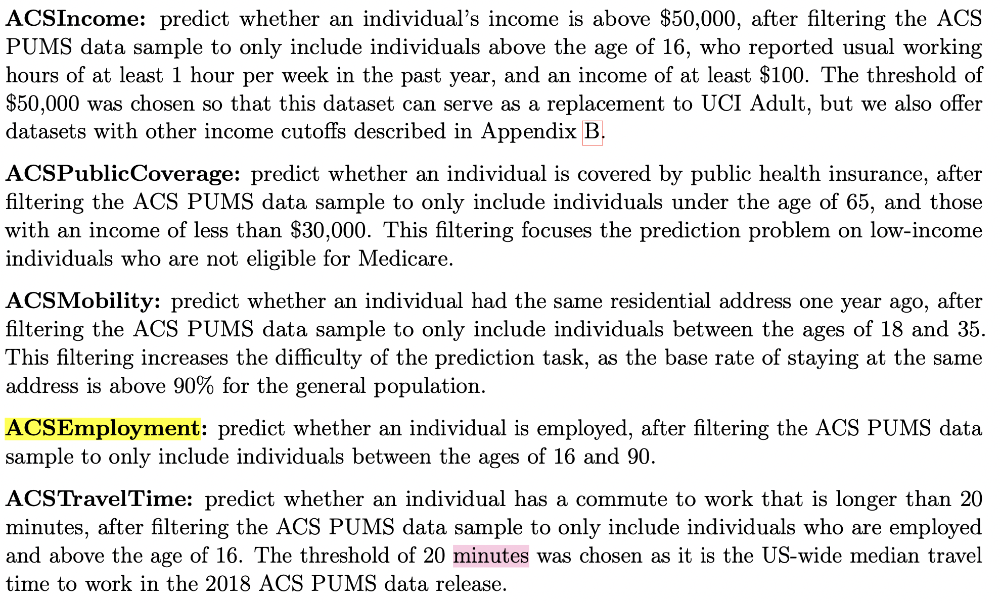

In [50]:
data_source = ACSDataSource(
    survey_year='2016',
    horizon='1-Year',
    survey='person'
)
acs_data = data_source.get_data(states=['TX'], download=True)
features, label, group = ACSEmployment.df_to_numpy(acs_data)
features.shape, label.shape, group.shape

((261896, 16), (261896,), (261896,))

In [51]:
X, y = acs_data[ACSEmployment.features].copy(), pd.DataFrame(acs_data[ACSEmployment.target].copy())
X_without_nulls, y_without_nulls = pd.DataFrame(features, columns=ACSEmployment.features), pd.DataFrame(label)
y_without_nulls.rename(columns={0: ACSEmployment.target}, inplace=True)

full = pd.concat([y, X], axis=1)
full_without_nulls = pd.concat([y_without_nulls, X_without_nulls], axis=1)
full.head()

,ESR,AGEP,SCHL,MAR,RELP,DIS,ESP,CIT,MIG,MIL,ANC,NATIVITY,DEAR,DEYE,DREM,SEX,RAC1P
0,6.0,33,12.0,1,0,2,NaN,5,1.0,4.0,4,2,2,2,2.0,2,1
1,1.0,35,12.0,1,1,2,NaN,5,1.0,4.0,4,2,2,2,2.0,1,1
2,NaN,12,9.0,5,2,2,2.0,1,1.0,NaN,4,1,2,2,2.0,1,1
3,NaN,7,4.0,5,2,2,2.0,1,1.0,NaN,4,1,2,2,2.0,1,1
4,NaN,0,NaN,5,2,2,2.0,1,NaN,NaN,4,1,2,2,NaN,2,1


### Why and how they encode values from ESP?

In [58]:
y['ESR'].unique()

array([ 6.,  1., nan,  2.,  3.,  4.,  5.])

In [60]:
y_without_nulls['ESR'].unique()

array([False,  True])

### Null distribution

In [52]:
getsizeof(full)

35618016

In [53]:
100 * full.isna().sum() / len(full)

ESR         20.634527
AGEP         0.000000
SCHL         3.447170
MAR          0.000000
RELP         0.000000
DIS          0.000000
ESP         77.833568
CIT          0.000000
MIG          1.119528
MIL         22.067538
ANC          0.000000
NATIVITY     0.000000
DEAR         0.000000
DEYE         0.000000
DREM         5.804594
SEX          0.000000
RAC1P        0.000000
dtype: float64

### Distribution of all people features (except age)

In [66]:
columns = full.copy().columns.tolist()
columns.remove('AGEP')
figure = make_subplots(rows=8, cols=2, subplot_titles=columns)

for idx, column in enumerate(columns):
    row, col = idx // 2 + 1, idx % 2 + 1
    figure.add_histogram(x=full[column], row=row, col=col, name=column)
figure.update_layout(title='Distribution of all people features', title_x=.5,
                     height=1000, showlegend=False)
figure.show()

### Distribution of all people features without nulls

In [67]:
columns = full.copy().columns.tolist()
columns.remove('AGEP')
figure = make_subplots(rows=8, cols=2, subplot_titles=columns)

for idx, column in enumerate(columns):
    row, col = idx // 2 + 1, idx % 2 + 1
    figure.add_histogram(x=full_without_nulls[column], row=row, col=col, name=column)
figure.update_layout(title='Distribution of all people features without nulls', title_x=.5,
                     height=1000, showlegend=False)
figure.show()

### Distribution of 92 y.o. people features

In [68]:
full_92 = full[full['AGEP'] > 91]
columns = full.copy().columns.tolist()
columns.remove('AGEP')
figure = make_subplots(rows=8, cols=2, subplot_titles=columns)

for idx, column in enumerate(columns):
    row, col = idx // 2 + 1, idx % 2 + 1
    figure.add_histogram(x=full_92[column], row=row, col=col, name=column)
figure.update_layout(title='Distribution of 92 y.o. people features', title_x=.5,
                     height=1000, showlegend=False)
figure.show()

### Distribution of 92 y.o. people features (with encoded nulls)

In [69]:
full_92_without_nulls = full_without_nulls[full_without_nulls['AGEP'] > 91]
columns = full.copy().columns.tolist()
columns.remove('AGEP')
figure = make_subplots(rows=8, cols=2, subplot_titles=columns)

for idx, column in enumerate(columns):
    row, col = idx // 2 + 1, idx % 2 + 1
    figure.add_histogram(x=full_92_without_nulls[column], row=row, col=col, name=column)
figure.update_layout(title='Distribution of 92 y.o. people features (with encoded nulls)', title_x=.5,
                     height=1000, showlegend=False)
figure.show()

In [70]:
cols_with_nulls = full.columns[full.isna().any()].tolist()
cols_with_nulls

['ESR', 'SCHL', 'ESP', 'MIG', 'MIL', 'DREM']

In [71]:
race_dict = {
    1: 'White',
    2: 'Black or African American',
    3: 'American Indian',
    4: 'Alaska Native',
    5: 'tribes specified',
    6: 'Asian',
    7: 'Native Hawaiian',
    8: 'Other Race',
    9: 'Two or More Races'
}

### Plot the nulls distribution for each column


In [9]:
for null_column in cols_with_nulls:
    temp_df = full[full[null_column].isna()]
    temp_df['RAC1P'] = temp_df['RAC1P'].apply(lambda x: race_dict[x])
    fig = px.histogram(temp_df, x='AGEP', color='RAC1P')
    fig.update_layout(title=f'Nulls in {null_column} column', title_x=.5)
    fig.show()

Why is the numbers in the same row different? It's the count, it should be the same...

Maybe this is due to nulls (nulls aren't counted as values)

In [10]:
temp_df = full[full[null_column].isna()]
temp_df['RAC1P'] = temp_df['RAC1P'].apply(lambda x: race_dict[x])
grouped = temp_df.groupby('RAC1P').count()
grouped

,ESR,AGEP,SCHL,MAR,RELP,DIS,ESP,CIT,MIG,MIL,ANC,NATIVITY,DEAR,DEYE,DREM,SEX
RAC1P,,,,,,,,,,,,,,,,
American Indian,0,46,19,46,46,46,46,46,39,0,46,46,46,46,0,46
Asian,0,665,277,665,665,665,658,665,530,0,665,665,665,665,0,665
Black or African American,0,1433,552,1433,1433,1433,1308,1433,1160,0,1433,1433,1433,1433,0,1433
Native Hawaiian,0,18,4,18,18,18,12,18,16,0,18,18,18,18,0,18
Other Race,0,838,338,838,838,838,812,838,686,0,838,838,838,838,0,838
Two or More Races,0,873,323,873,873,873,843,873,688,0,873,873,873,873,0,873
White,0,11311,4656,11311,11311,11311,10964,11311,9139,0,11311,11311,11311,11311,0,11311
tribes specified,0,18,5,18,18,18,17,18,12,0,18,18,18,18,0,18


I don't understand why so inconsistent numbers? I divide number of nulls in a specific race by total number of individuals with such race. So it should not exceed 1.

But it is not the case in the real data.

In [11]:
for null_column in cols_with_nulls:
    temp_df_with_nulls = full[full[null_column].isna()]

    temp_df['RAC1P'] = full['RAC1P'].apply(lambda x: race_dict[x])
    temp_df_with_nulls['RAC1P'] = temp_df_with_nulls['RAC1P'].apply(lambda x: race_dict[x])

    grouped = temp_df.groupby('RAC1P')['AGEP'].count()
    grouped_with_nulls = temp_df_with_nulls.groupby('RAC1P')['AGEP'].count()
    print(null_column)
    print(grouped_with_nulls / grouped)

ESR
RAC1P
Alaska Native                     NaN
American Indian              3.869565
Asian                        3.500752
Black or African American    3.540823
Native Hawaiian              2.722222
Other Race                   3.791169
Two or More Races            3.082474
White                        3.575369
tribes specified             5.611111
Name: AGEP, dtype: float64
SCHL
RAC1P
American Indian              0.586957
Asian                        0.583459
Black or African American    0.614794
Native Hawaiian              0.777778
Other Race                   0.596659
Two or More Races            0.630011
White                        0.588365
tribes specified             0.722222
Name: AGEP, dtype: float64
ESP
RAC1P
Alaska Native                      NaN
American Indian              17.043478
Asian                        13.760902
Black or African American    14.448709
Native Hawaiian               9.055556
Other Race                   11.647971
Two or More Races             4.557

I wanted to plot relative nulls by race. I.e. how many percent of each race have nulls? But I can't...

In [12]:
for null_column in cols_with_nulls:
    temp_df = full[full[null_column].isna()]
    temp_df['RAC1P'] = full['RAC1P'].apply(lambda x: race_dict[x])
    grouped = temp_df.groupby('RAC1P')['AGEP'].count()

    fig = px.bar(grouped)
    fig.update_layout(title=f'Distribution of nulls in {null_column} column by race',
                      title_x=.5, showlegend=False)
    fig.update_yaxes(type='log')
    fig.show()

In [13]:
for null_column in cols_with_nulls:
    temp_df = full[full[null_column].isna()]
    grouped = temp_df.groupby('SEX')['AGEP'].count()

    fig = px.bar(grouped)
    fig.update_layout(title=f'Distribution of nulls in {null_column} column by gender',
                      title_x=.5, showlegend=False )
    fig.show()

### Check if age restrictions are satisfied in other datasets

In [14]:
datasets = [ACSIncome, ACSPublicCoverage,
            ACSMobility, ACSEmployment,
            ACSTravelTime
]
names = [
         'ACSIncome', 'ACSPublicCoverage',
         'ACSMobility', 'ACSEmployment',
         'ACSTravelTime'
]
restrictions = [
                (16, 1000), (-1, 65),
                (18, 35), (16, 90),
                (16, 1000)
]
age_restrictions = dict(zip(names, restrictions))


for idx, dataset in enumerate(datasets):
    print(names[idx])
    features, label, group = dataset.df_to_numpy(acs_data)
    print(len(features))

    X, y = acs_data[dataset.features].copy(), pd.DataFrame(acs_data[dataset.target].copy())
    X_without_nulls, y_without_nulls = pd.DataFrame(features, columns=dataset.features), pd.DataFrame(label)
    y_without_nulls.rename(columns={0: dataset.target}, inplace=True)

    Min, Max = age_restrictions[names[idx]]
    not_satisfied = X[X['AGEP'].apply(lambda x: not Min < x < Max)]
    print(f"{round(100 * len(not_satisfied) / len(X), 2)}% of data doesn't satisfy age restriction")



ACSIncome
131089
22.07% of data doesn't satisfy age restriction
ACSPublicCoverage
100882
16.29% of data doesn't satisfy age restriction
ACSMobility
52384
80.0% of data doesn't satisfy age restriction
ACSEmployment
261896
22.92% of data doesn't satisfy age restriction
ACSTravelTime
115819
22.07% of data doesn't satisfy age restriction


### Alaska Native and their ESR equals 1 in NY

In [ ]:
data_source = ACSDataSource(
    survey_year='2016',
    horizon='1-Year',
    survey='person'
)
acs_data = data_source.get_data(states=['NY'], download=True)
features, label, group = ACSEmployment.df_to_numpy(acs_data)
features.shape, label.shape, group.shape

X, y = acs_data[ACSEmployment.features].copy(), pd.DataFrame(acs_data[ACSEmployment.target].copy())
X_without_nulls, y_without_nulls = pd.DataFrame(features, columns=ACSEmployment.features), pd.DataFrame(label)
y_without_nulls.rename(columns={0: ACSEmployment.target}, inplace=True)

full = pd.concat([y, X], axis=1)
full_without_nulls = pd.concat([y_without_nulls, X_without_nulls], axis=1)
full.head()

In [77]:
for_Alaska = full_without_nulls.copy()
almost_numerical = ['AGEP'] + ['SCHL', ACSEmployment.target]

for_Alaska['RAC1P'] = for_Alaska['RAC1P'].apply(lambda x: race_dict[x])

for_Alaska.groupby('SEX')[almost_numerical].mean()

,AGEP,SCHL,ESR
SEX,,,
1.0,37.944939,14.769962,0.483535
2.0,40.135659,15.049127,0.405437


In [78]:
for_Alaska.groupby('RAC1P')[almost_numerical].mean()

,AGEP,SCHL,ESR
RAC1P,,,
Alaska Native,43.111111,14.777778,0.444444
American Indian,39.109184,15.205102,0.437755
Asian,36.314953,16.038300,0.493973
Black or African American,38.180268,15.048866,0.412450
Native Hawaiian,32.632850,14.280193,0.434783
Other Race,33.585081,12.384686,0.456700
Two or More Races,27.272141,12.432111,0.337977
White,40.097437,15.080353,0.447736
tribes specified,34.800895,13.042506,0.431767
